Benchmark of DLPFC dataset

In [1]:
import os,sys
sys.path.append(os.path.realpath(os.path.join(os.getcwd(), '..')))
import warnings
import scanpy as sc
import anndata as ad
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import mucostx as mx

In [2]:
opt = mx.config()
args = opt.parse_args(['--gpu', '0'])
args.dataset_path = '/mnt/d/Dataset/SRT_Dataset/1-DLPFC/'
args.cluster = 7
if args.version.split('-')[0] != 'dev':
    warnings.filterwarnings("ignore")
args

Namespace(amp=True, batch_size=512, cluster=7, clusters=0, dataset_path='/mnt/d/Dataset/SRT_Dataset/1-DLPFC/', dropout=0.3, flow='source_to_target', gpu=0, hvgs=3000, latent_dim=64, log_file='../Log', log_steps=20, lr=0.001, max_epoch=100, max_neighbors=6, mode_rknn='rknn', n_spot=0, out_file='../Output', project_name='MoCoSTX', seed=2024, srt_resolution=150, tau=0.05, version='dev-1.0', visual=True, wegiht_decay=0.0001)

In [3]:
mx.set_random_seed(args.seed)

In [4]:
# sections = ['151673', '151674', '151675', '151676']
sections = ['151507', '151508', '151509', '151510','151669', '151670', '151671', '151672', '151673', '151674', '151675', '151676']

In [5]:
adata_list = []
for section in sections:
    adata = sc.read_visium(os.path.join(args.dataset_path+section))
    adata.var_names_make_unique()
    sc.pp.filter_genes(adata, min_cells=10)
    # sc.pp.filter_cells(adata, min_genes=200)
    # sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=10000)
    # adata = adata[:, adata.var['highly_variable']]
    Ann_df = pd.read_csv(os.path.join(args.dataset_path+'1-DLPFC_annotations/', section+'_truth.txt'), sep='\t', header=None, index_col=0)
    Ann_df.columns = ['Ground Truth']
    adata.obs['Ground Truth'] = Ann_df.loc[adata.obs_names, 'Ground Truth']
    adata_list.append(adata)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are n

Before alignment

In [6]:
adata_raw = ad.concat(adata_list, keys=sections,label="slice_name", join='inner')
sc.pp.highly_variable_genes(adata_raw, flavor="seurat_v3", n_top_genes=3000)
global_hvg = adata_raw.var_names[adata_raw.var['highly_variable']]
sc.pp.filter_cells(adata_raw, min_genes=200)
sc.pp.normalize_total(adata_raw, target_sum=1e4)
sc.pp.log1p(adata_raw)
adata_raw = adata_raw[:, global_hvg]
sc.pp.scale(adata_raw, zero_center=True, max_value=10)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [7]:
adata_raw

AnnData object with n_obs × n_vars = 47632 × 3000
    obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'slice_name', 'n_genes'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p'
    obsm: 'spatial'

In [8]:
def mclust(adata, arg, refine=False):
    from sklearn.decomposition import PCA
    pca = PCA(n_components=32, random_state=arg.seed)
    embedding = pca.fit_transform(adata.X.copy())
    adata.obsm['emb_pca'] = embedding
    import rpy2.robjects as r_objects
    r_objects.r.library("mclust")
    import rpy2.robjects.numpy2ri
    rpy2.robjects.numpy2ri.activate()
    r_random_seed = r_objects.r['set.seed']
    r_random_seed(arg.seed)
    rmclust = r_objects.r['Mclust']
    res = rmclust(rpy2.robjects.numpy2ri.numpy2rpy(adata.obsm['emb_pca']), arg.n_domain, 'EEE')

    mclust_res = np.array(res[-2])
    adata.obs['mclust'] = mclust_res
    adata.obs['mclust'] = adata.obs['mclust'].astype('int')
    adata.obs['mclust'] = adata.obs['mclust'].astype('category')

    return adata

In [9]:
# args.n_domain=7
# adata_new = mclust(adata_raw, args, refine=False)
# sc.pp.neighbors(adata_new, use_rep='emb_pca')
# sc.tl.umap(adata_new)
# plt.rcParams["figure.figsize"] = (5, 5)
# sc.pl.umap(adata_new, color=["mclust", "Ground Truth", 'slice_name'], ncols=3,wspace=0.3, show=True)
# from sklearn.metrics import adjusted_rand_score
# adata_new = adata_new[~pd.isnull(adata_new.obs['Ground Truth'])]
# obs_df = adata_new.obs.dropna()
# ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
# print(f'overall ARI: {ARI}')
# for i, sli in enumerate(sections):
#     adata_151 = adata_new[adata_new.obs['slice_name']==sli,:]
#     adata_151
#     sc.pl.umap(adata_151, color=["mclust", "Ground Truth"])
#     adata_151.uns = adata_list[i].uns
#     sc.pl.spatial(adata_151,color=["mclust", "Ground Truth"])
#     from sklearn.metrics import adjusted_rand_score
#     adata_151 = adata_151[~pd.isnull(adata_151.obs['Ground Truth'])]
#     obs_df = adata_151.obs.dropna()
#     ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
#     print(f'section {sli}, ARI: {ARI}')

In [10]:
mucostx = mx.MuCoSTX(adata_list, args)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/preprocess

section 4217 and 2972 has 8998 mnn edges
section 4217 and 1956 has 8789 mnn edges
section 4217 and 3739 has 8912 mnn edges
section 4217 and 1110 has 7128 mnn edges
section 4217 and 1973 has 7092 mnn edges
section 4217 and 764 has 7403 mnn edges
section 4217 and 3094 has 7298 mnn edges
section 4217 and 1325 has 6529 mnn edges
section 4217 and 287 has 6944 mnn edges
section 4217 and 2458 has 7131 mnn edges
section 4217 and 2746 has 6880 mnn edges
section 4377 and 1776 has 8951 mnn edges
section 4377 and 3826 has 8889 mnn edges
section 4377 and 1437 has 6873 mnn edges
section 4377 and 2897 has 6671 mnn edges
section 4377 and 3091 has 7286 mnn edges
section 4377 and 3038 has 7052 mnn edges
section 4377 and 1343 has 5911 mnn edges
section 4377 and 1498 has 6326 mnn edges
section 4377 and 28 has 6623 mnn edges
section 4377 and 3267 has 6319 mnn edges
section 4783 and 1456 has 10330 mnn edges
section 4783 and 921 has 6714 mnn edges
section 4783 and 702 has 6584 mnn edges
section 4783 and 3240

  0%|          | 0/100 [00:00<?, ?it/s]

x dim 7489 spa edge 2985 sf edge 7824
x dim 7566 spa edge 2967 sf edge 7976
x dim 7600 spa edge 2986 sf edge 8036
x dim 7383 spa edge 2994 sf edge 7612
x dim 7476 spa edge 2994 sf edge 7811
x dim 7782 spa edge 2984 sf edge 8149
x dim 8010 spa edge 2985 sf edge 8514
x dim 7103 spa edge 2983 sf edge 7332
x dim 7705 spa edge 2965 sf edge 8083
x dim 7714 spa edge 2974 sf edge 8006
x dim 7544 spa edge 3010 sf edge 7964
x dim 7498 spa edge 2989 sf edge 7877
x dim 7453 spa edge 2968 sf edge 7746
x dim 7669 spa edge 2982 sf edge 8023
x dim 7456 spa edge 2985 sf edge 7734
x dim 7547 spa edge 2974 sf edge 7871
x dim 7774 spa edge 2968 sf edge 8128
x dim 7679 spa edge 2990 sf edge 8022
x dim 7734 spa edge 2971 sf edge 8053
x dim 7891 spa edge 2980 sf edge 8426
x dim 7599 spa edge 2967 sf edge 8008
x dim 7732 spa edge 2982 sf edge 8158
x dim 7555 spa edge 2960 sf edge 7992
x dim 7773 spa edge 2976 sf edge 8260
x dim 7426 spa edge 2972 sf edge 7781
x dim 7443 spa edge 2963 sf edge 7799
x dim 7371 s

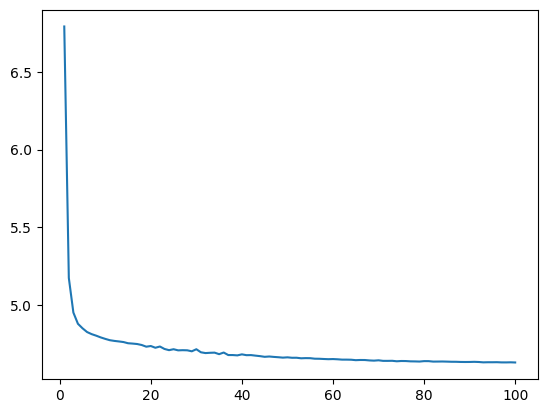

In [11]:
mucostx.train_emb()

Downstream workflow

In [12]:
list_new = mucostx.get_adata_all()
list_new

[AnnData object with n_obs × n_vars = 4218 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
     uns: 'spatial', 'log1p'
     obsm: 'spatial', 'X_pca', 'mxb', 'mx',
 AnnData object with n_obs × n_vars = 4378 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
     uns: 'spatial', 'log1p'
     obsm: 'spatial', 'X_pca', 'mxb', 'mx',
 AnnData object with n_obs × n_vars = 4784 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mean', 'std'
     uns: 'spatial', 'log1p'
     obsm: 'spatial', 'X_pca', 'mxb', 'mx',
 AnnData object with n_obs × n_vars = 4626 × 3000
     obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes'
     var: 'gene_ids', 'feature_types', 'genome', 'n_cells',

In [13]:
adata_new1 = ad.concat(list_new, keys=sections,label="slice_name")

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [14]:
adata_new1

AnnData object with n_obs × n_vars = 47632 × 3000
    obs: 'in_tissue', 'array_row', 'array_col', 'Ground Truth', 'n_genes', 'slice_name'
    obsm: 'spatial', 'X_pca', 'mxb', 'mx'

In [15]:
from mucostx.utils import mclust
args.n_domain=7
adata_new1 = mclust(adata_new1, args, refine=False, use='mxb')
from sklearn.metrics import adjusted_rand_score
adata_new1 = adata_new1[~pd.isnull(adata_new1.obs['Ground Truth'])]
obs_df = adata_new1.obs.dropna()
ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
print(f'overall ARI: {ARI}')
# for i, sli in enumerate(sections):
#     adata_151 = adata_new1[adata_new1.obs['slice_name']==sli,:]
#     adata_151
#     sc.pl.umap(adata_151, color=["mclust", "Ground Truth"])
#     adata_151.uns = adata_list[i].uns
#     sc.pl.spatial(adata_151,color=["mclust", "Ground Truth"])
#     from sklearn.metrics import adjusted_rand_score
#     adata_151 = adata_151[~pd.isnull(adata_151.obs['Ground Truth'])]
#     obs_df = adata_151.obs.dropna()
#     ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
#     print(f'section {sli}, ARI: {ARI}')

   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.1.1
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%
overall ARI: 0.4908460492600538


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping pr

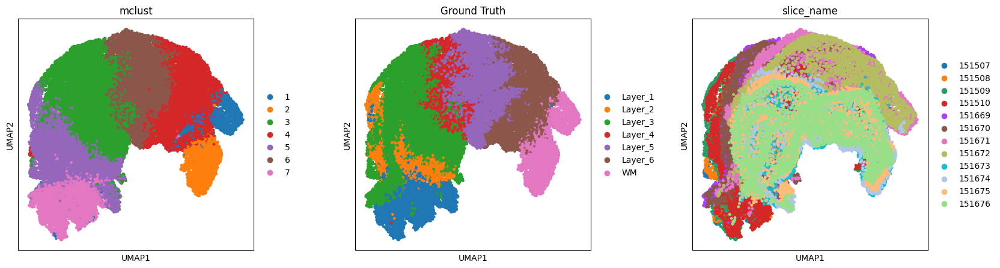

In [16]:
sc.pp.neighbors(adata_new1, use_rep='mxb')
sc.tl.umap(adata_new1)
plt.rcParams["figure.figsize"] = (5, 5)
sc.pl.umap(adata_new1, color=["mclust", "Ground Truth", 'slice_name'],size=50, ncols=3,wspace=0.3, show=True)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


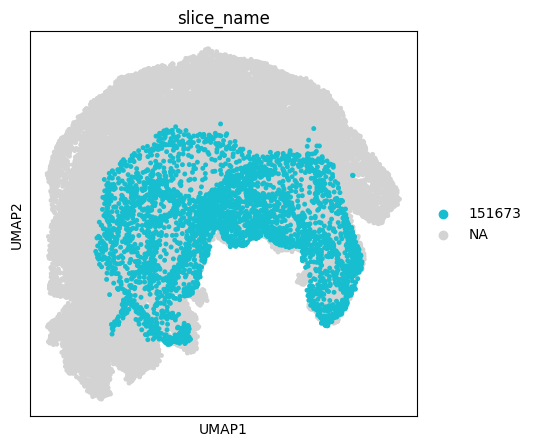

In [17]:
sc.pl.umap(adata_new1, color='slice_name', groups=[sections[-4]],size=50)

batch corrected

In [18]:
adata_new = ad.concat(list_new, keys=sections,label="slice_name")
from mucostx.utils import mclust
args.n_domain=7
adata_new = mclust(adata_new, args, refine=False, use='mx')

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


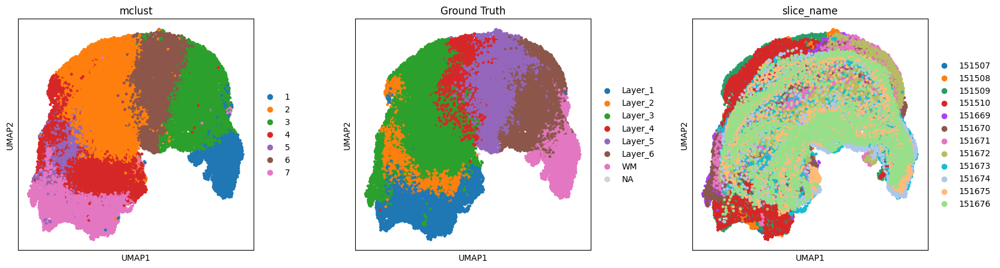

In [19]:
sc.pp.neighbors(adata_new, use_rep='mx')
sc.tl.umap(adata_new)
plt.rcParams["figure.figsize"] = (5, 5)
sc.pl.umap(adata_new, color=["mclust", "Ground Truth", 'slice_name'], ncols=3,wspace=0.3, show=True,size=50)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


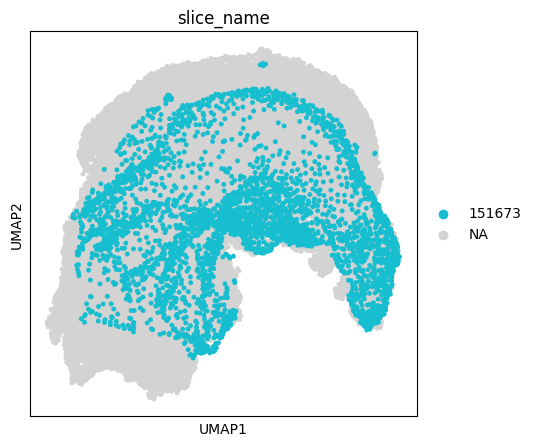

In [20]:
sc.pl.umap(adata_new, color='slice_name', groups=[sections[-4]],size=50)

In [21]:
abs(adata_new.obsm['mx'][3]).sum()

73.41188

In [22]:
import torch
aa = mucostx.model.batch_emb(torch.tensor([0]).to('cuda'))
abs(aa).sum()

tensor(18.0514, device='cuda:0', grad_fn=<SumBackward0>)

In [23]:
from sklearn.metrics import adjusted_rand_score
adata_new = adata_new[~pd.isnull(adata_new.obs['Ground Truth'])]
obs_df = adata_new.obs.dropna()
ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
print(f'overall ARI: {ARI}')

overall ARI: 0.4657708201067464


In [24]:
-

SyntaxError: invalid syntax (476313318.py, line 1)

/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


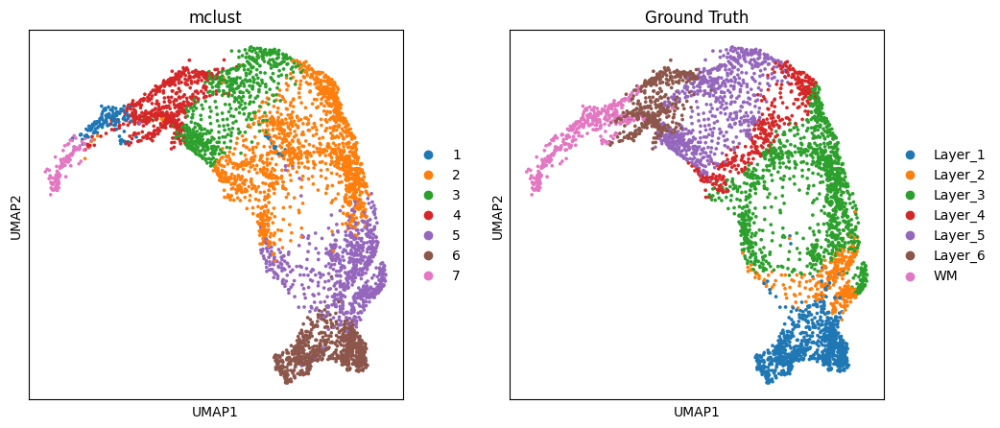

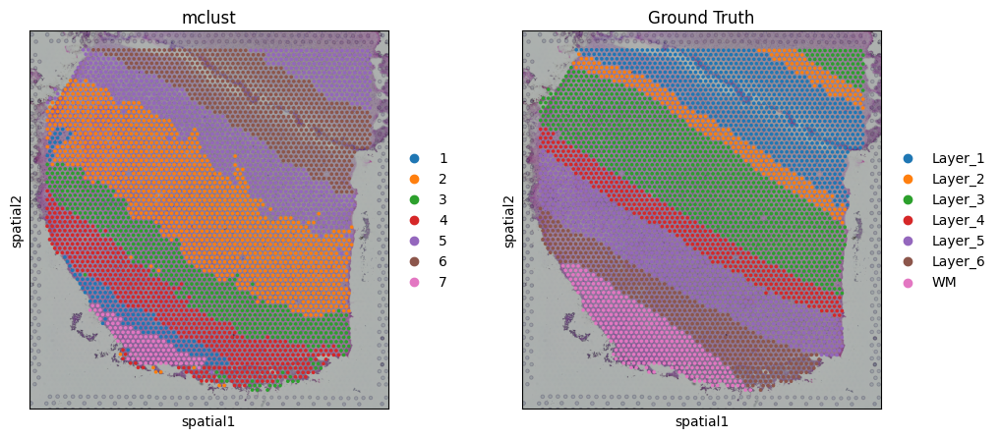

section 151507, ARI: 0.5278594807863842


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


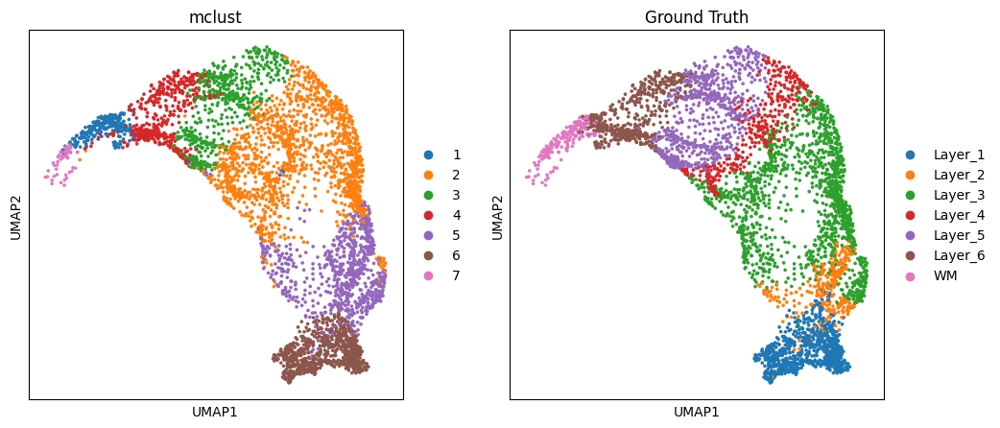

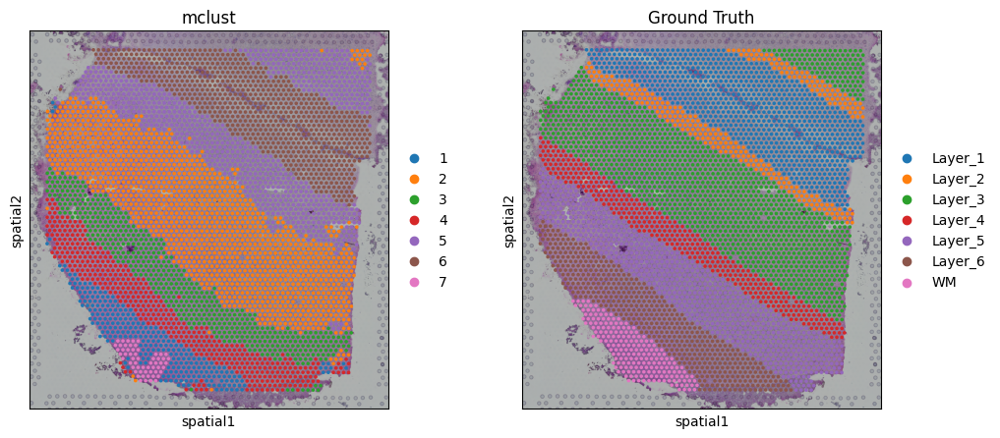

section 151508, ARI: 0.516108763292427


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


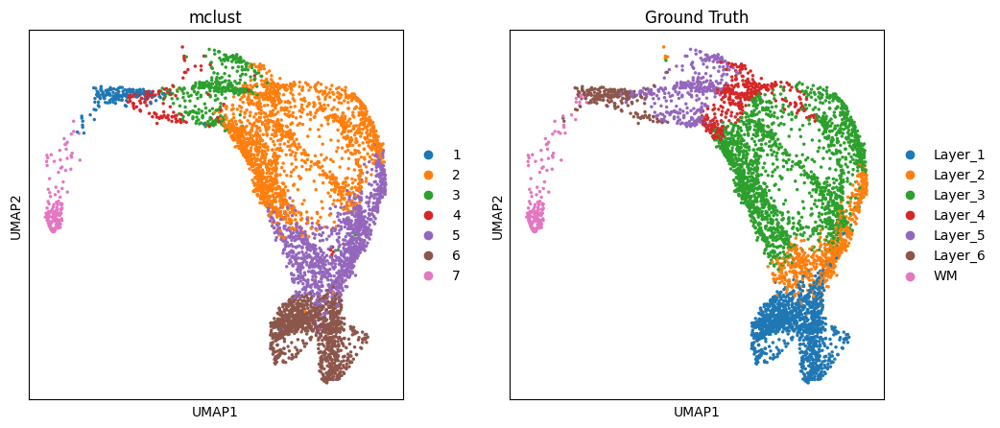

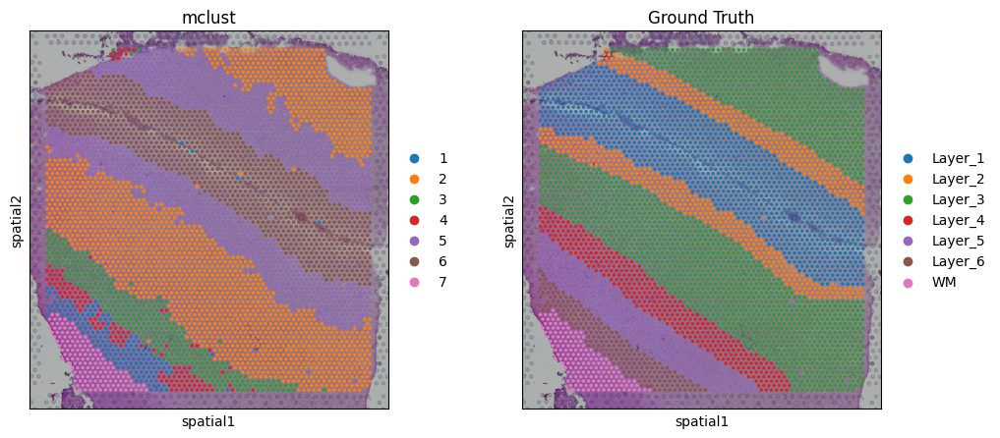

section 151509, ARI: 0.5906901801772646


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


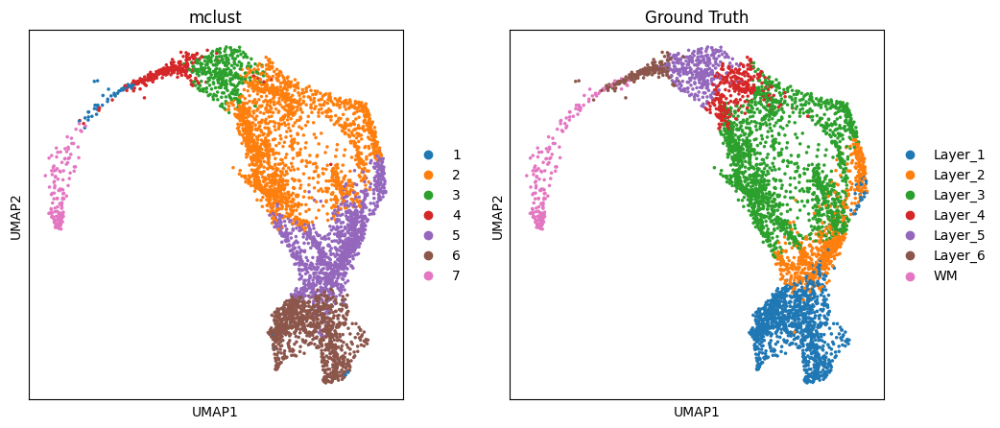

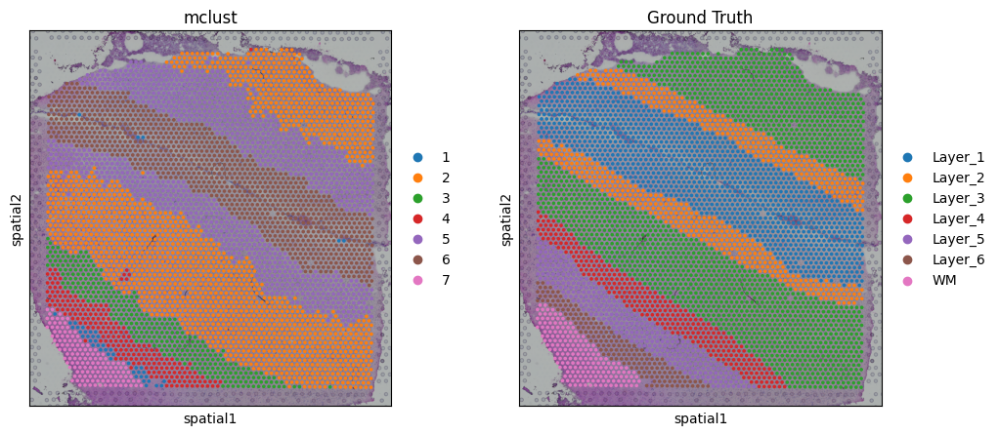

section 151510, ARI: 0.5992673935825603


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


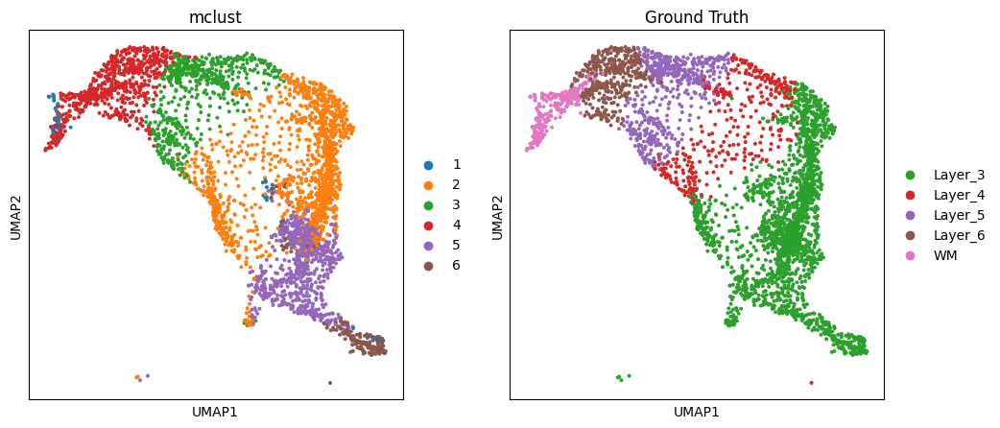

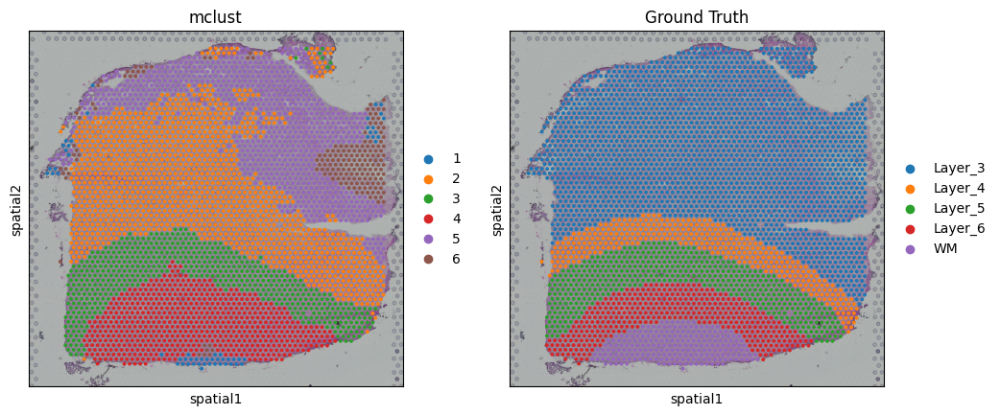

section 151669, ARI: 0.3740477351042363


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


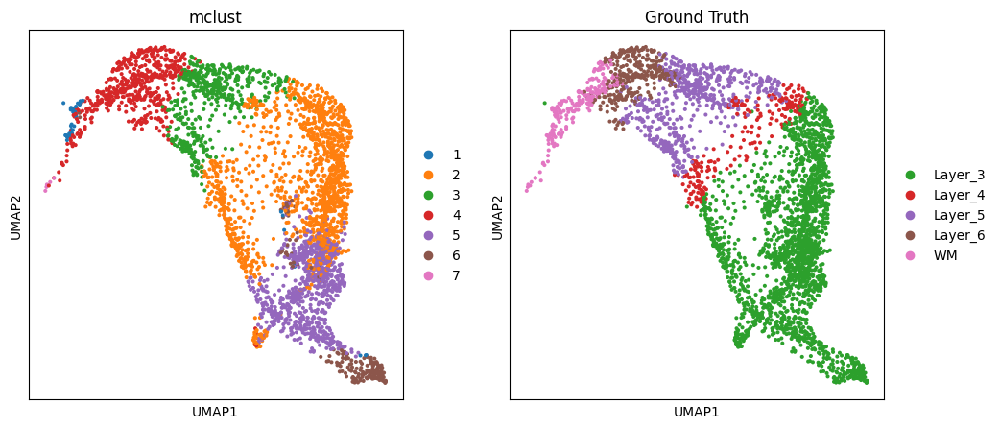

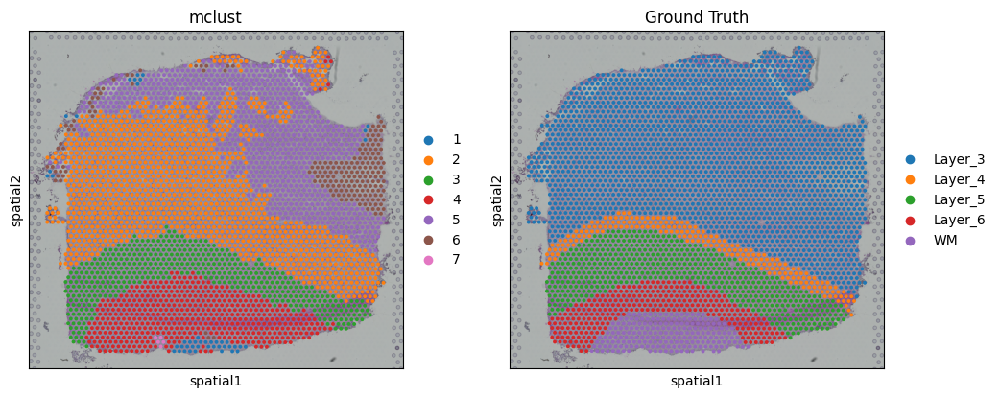

section 151670, ARI: 0.3545437032838303


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


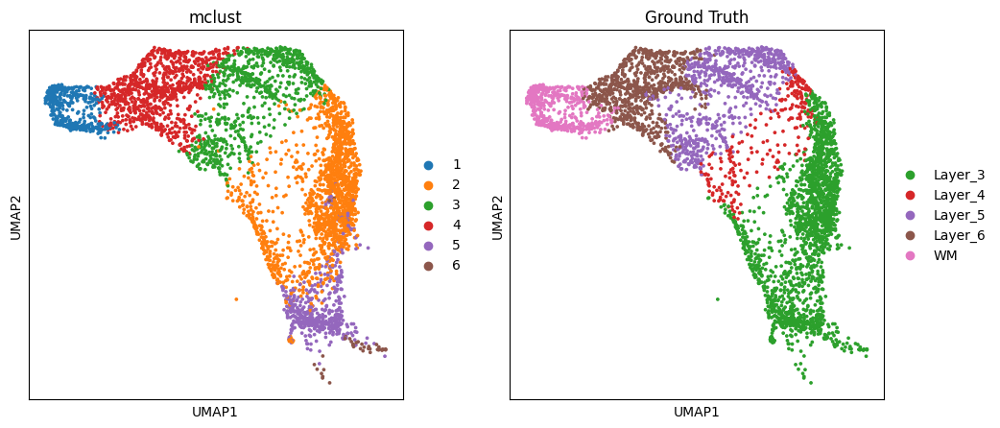

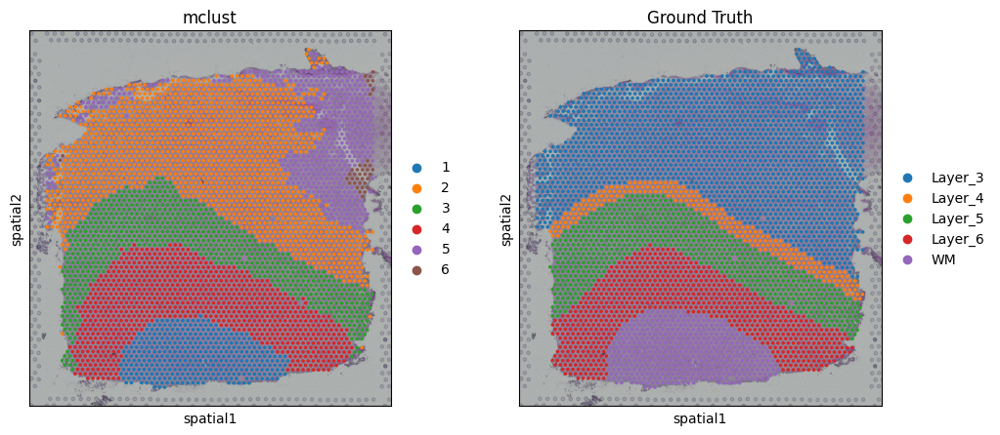

section 151671, ARI: 0.6055054038808259


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


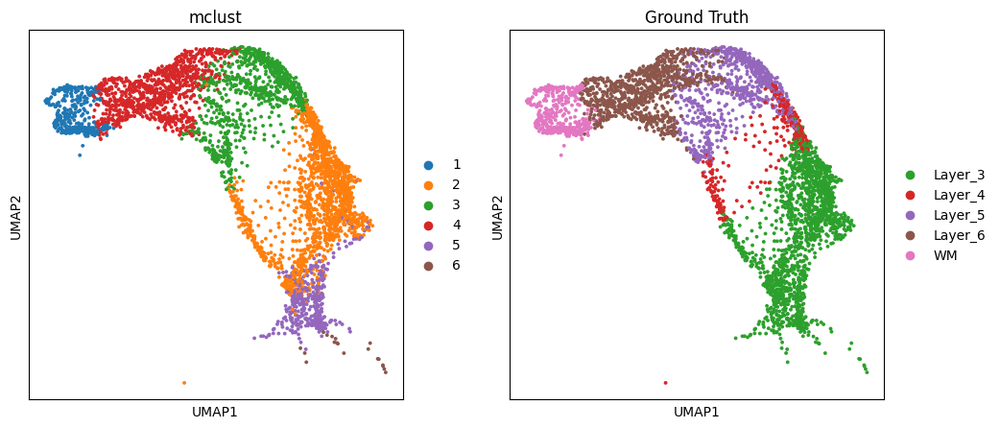

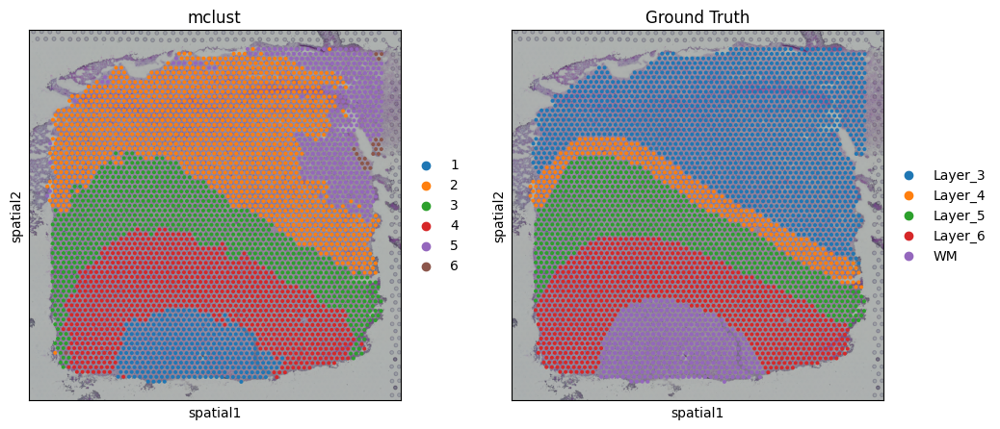

section 151672, ARI: 0.6152341109477801


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


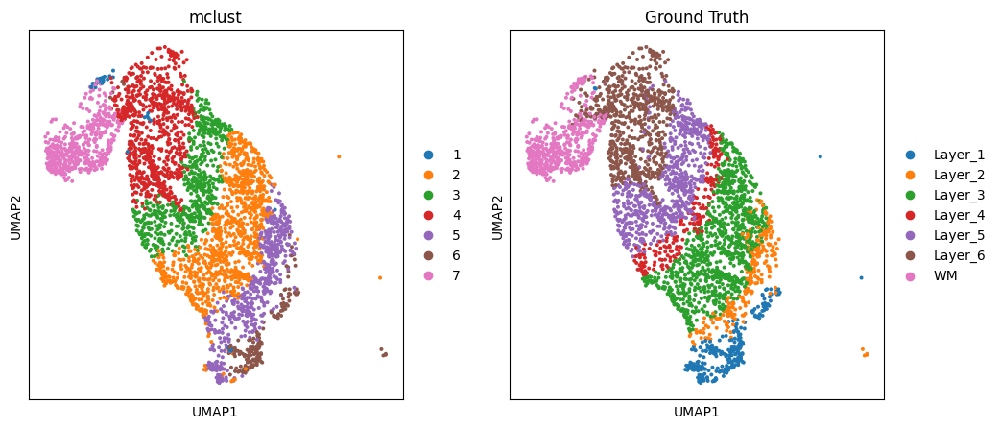

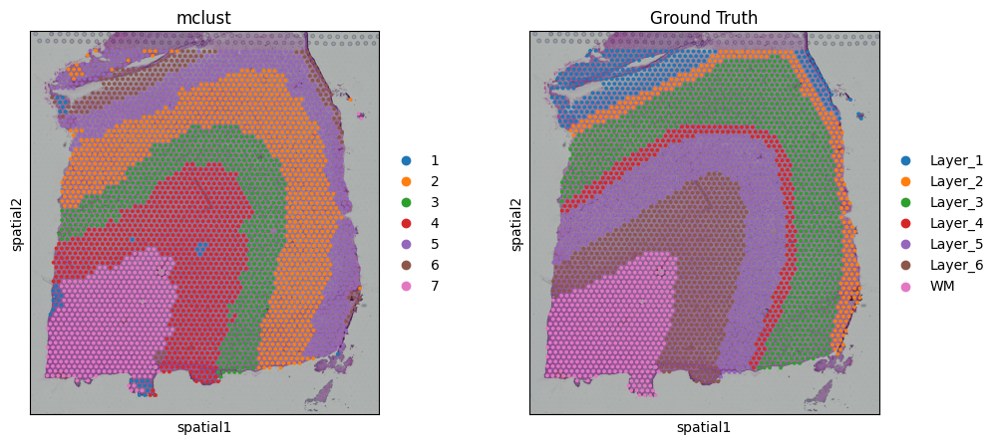

section 151673, ARI: 0.6330593333834773


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


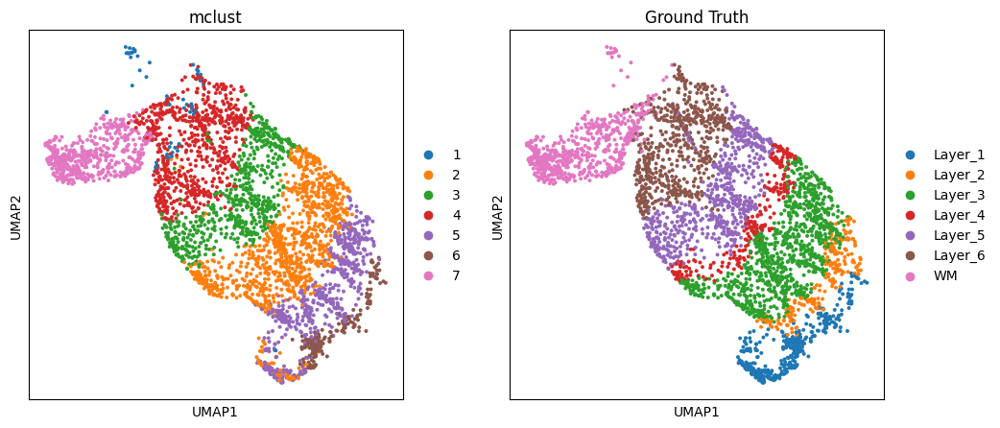

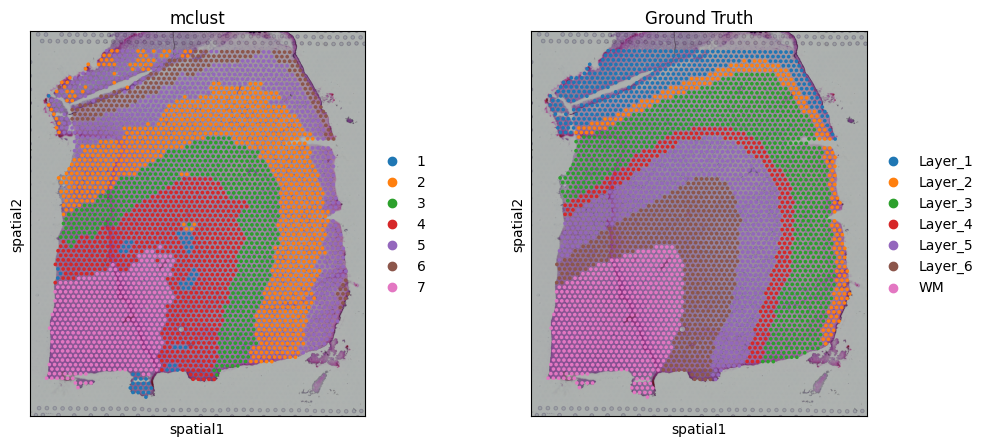

section 151674, ARI: 0.5990177493702201


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


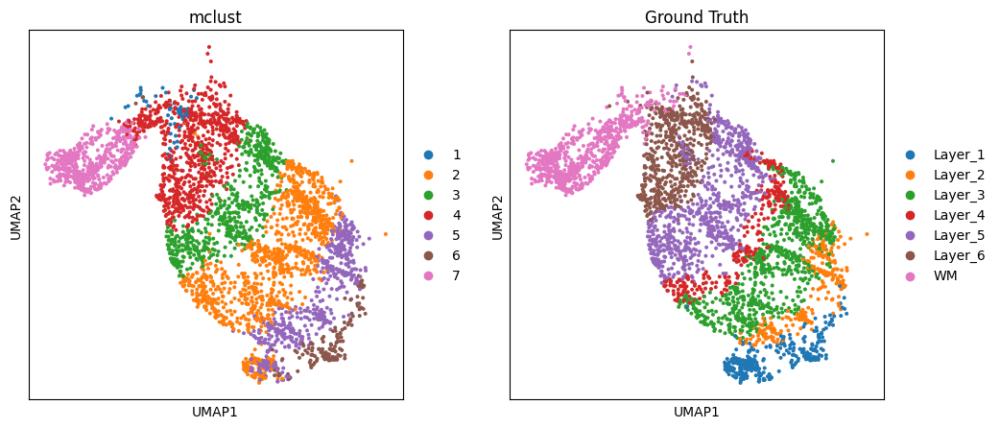

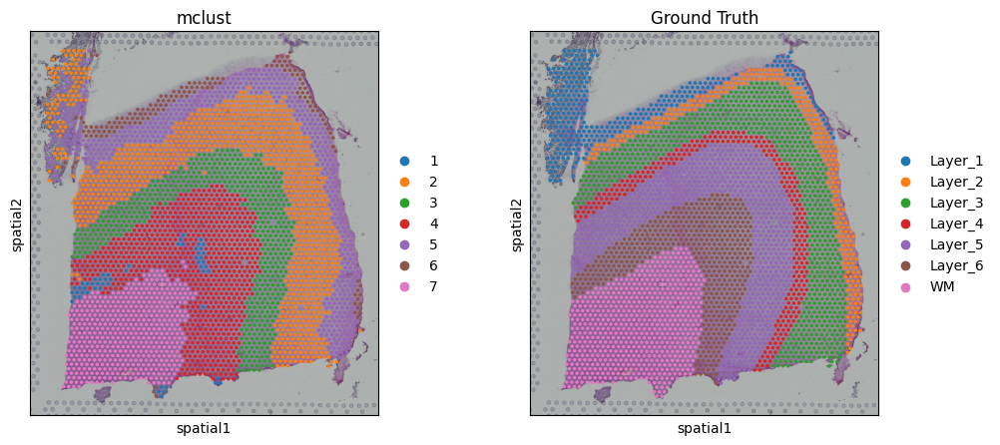

section 151675, ARI: 0.5171821760881625


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


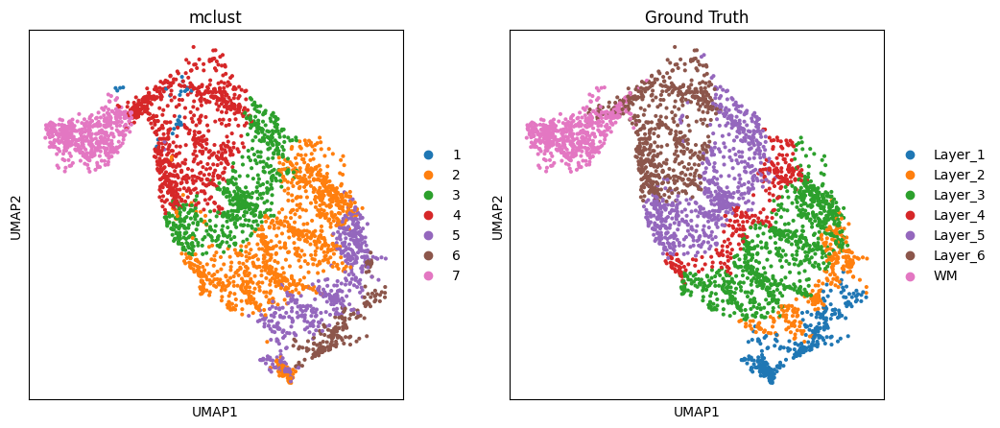

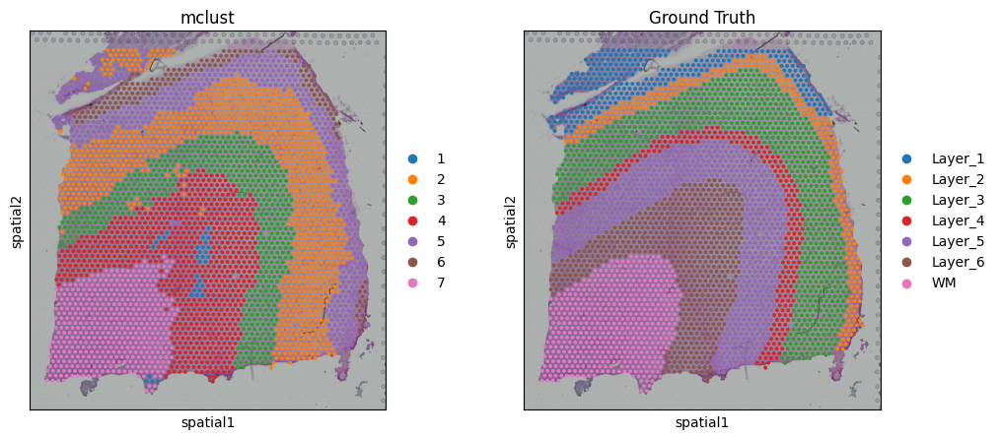

section 151676, ARI: 0.5857876960434091


In [ ]:
for i, sli in enumerate(sections):
    adata_151 = adata_new[adata_new.obs['slice_name']==sli,:]
    adata_151
    sc.pl.umap(adata_151, color=["mclust", "Ground Truth"])
    adata_151.uns = adata_list[i].uns
    sc.pl.spatial(adata_151,color=["mclust", "Ground Truth"])
    from sklearn.metrics import adjusted_rand_score
    adata_151 = adata_151[~pd.isnull(adata_151.obs['Ground Truth'])]
    obs_df = adata_151.obs.dropna()
    ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
    print(f'section {sli}, ARI: {ARI}')

In [ ]:
# save_dir = args.dataset_path+'adata_all/'
# os.makedirs(save_dir, exist_ok=True)

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


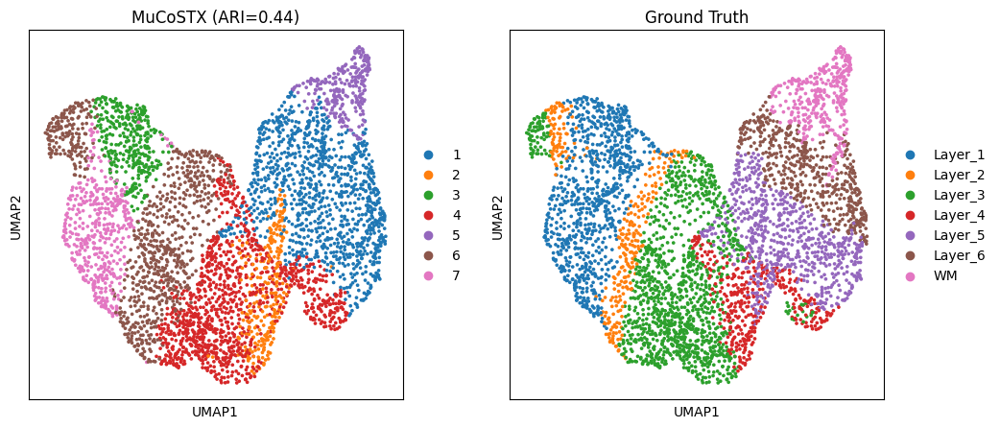

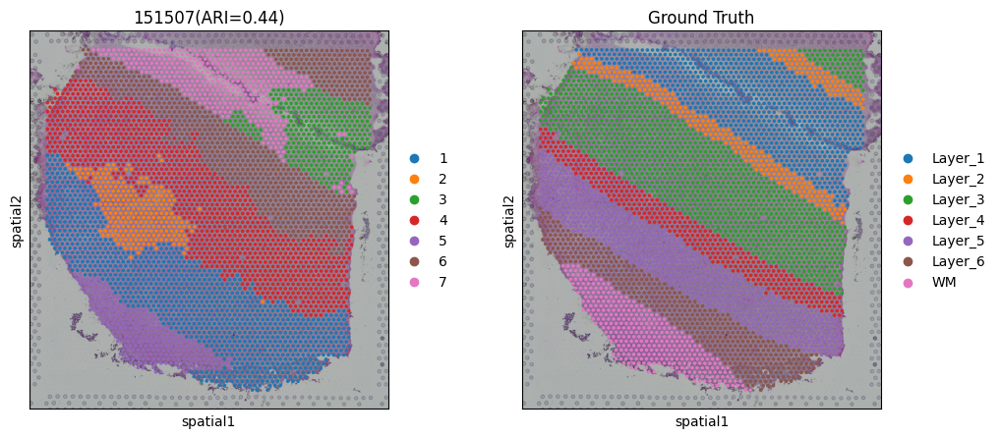

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


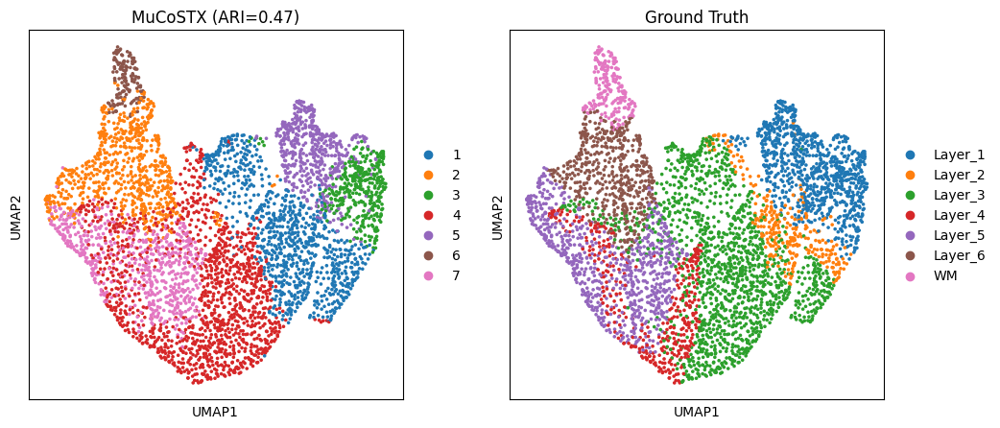

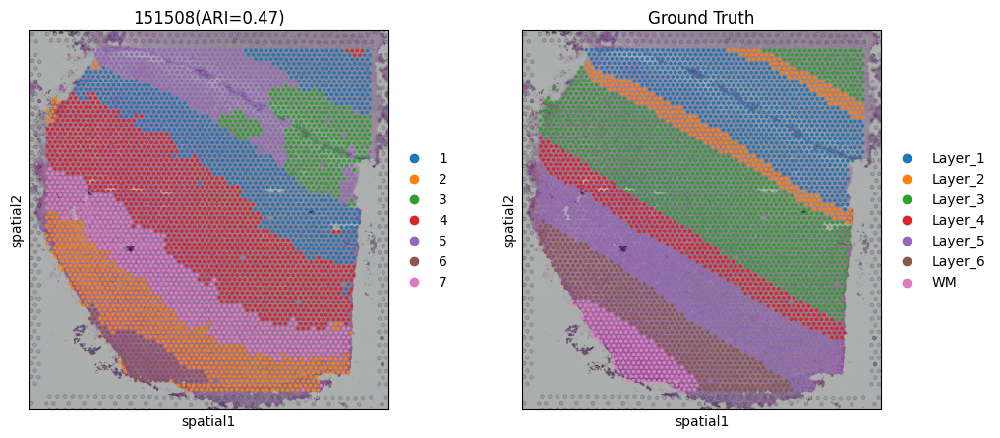

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


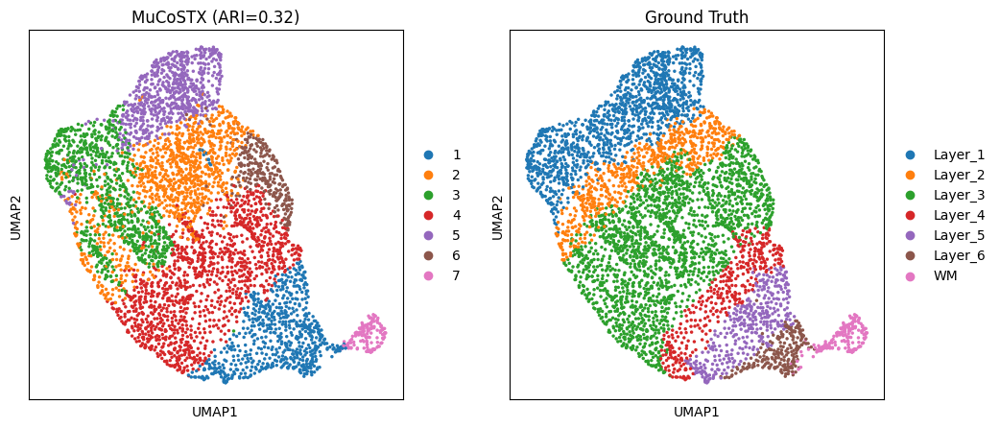

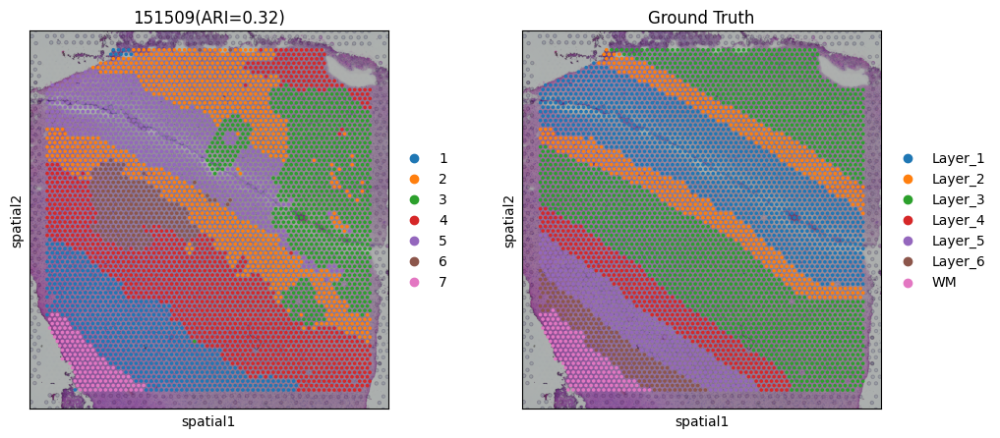

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


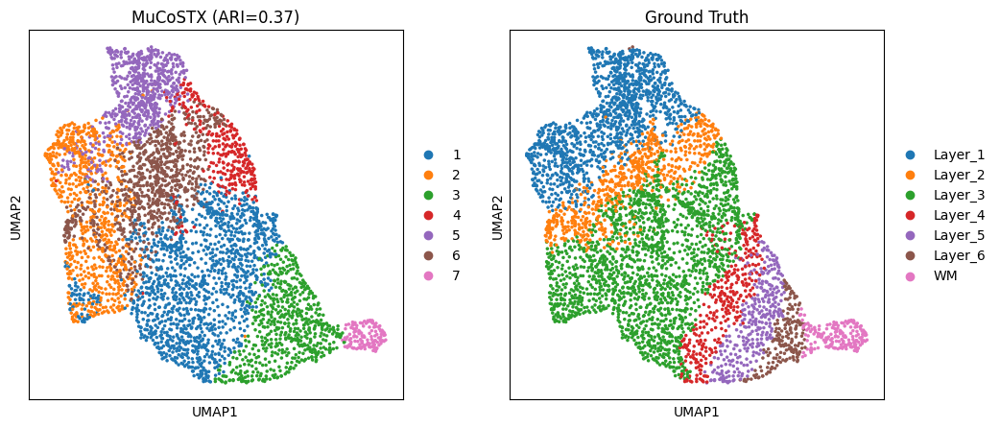

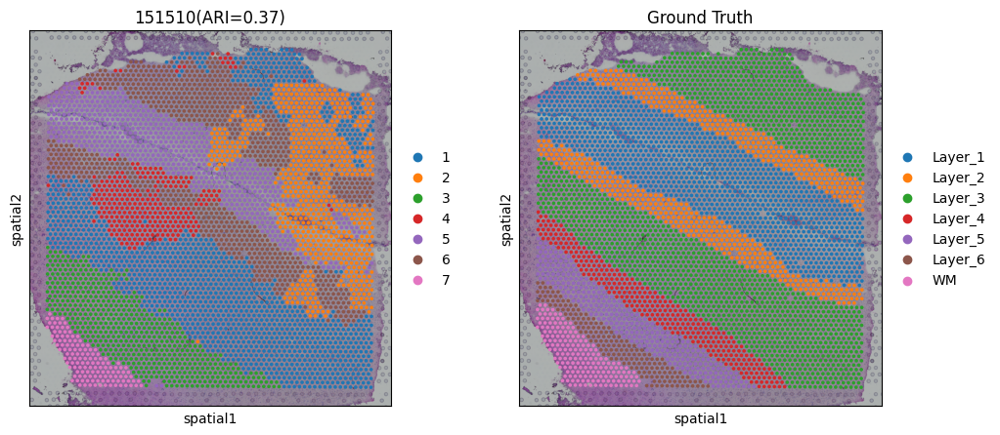

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


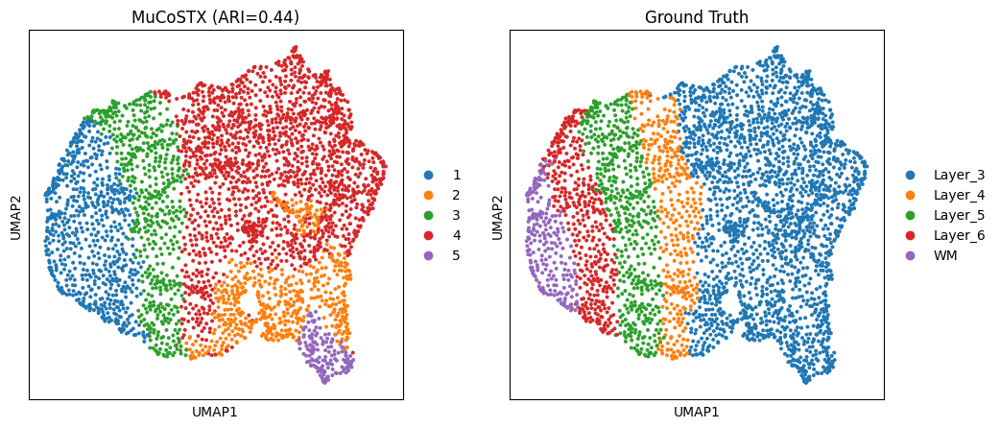

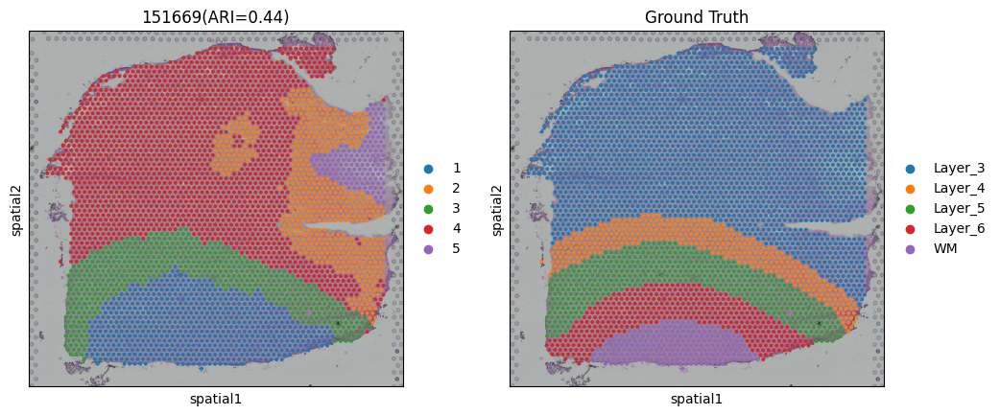

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


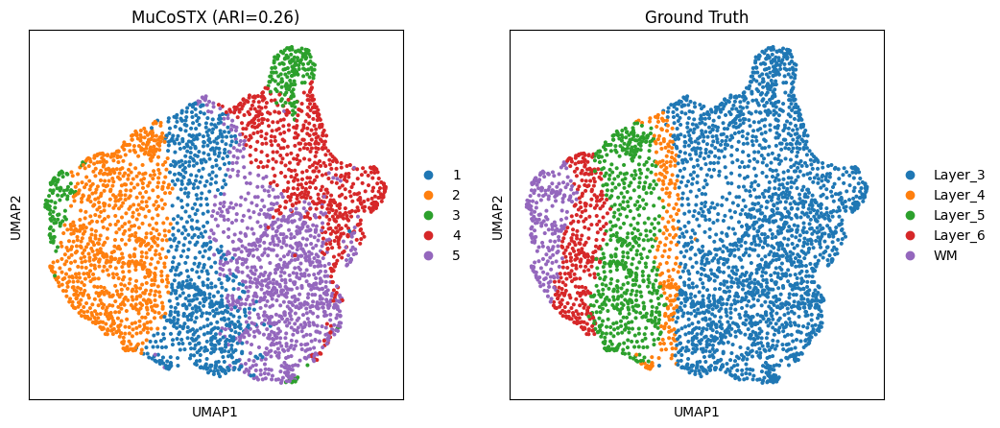

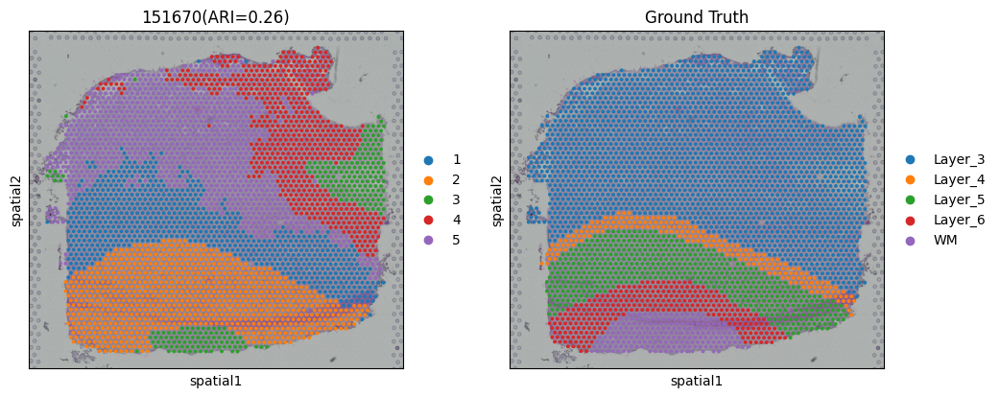

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


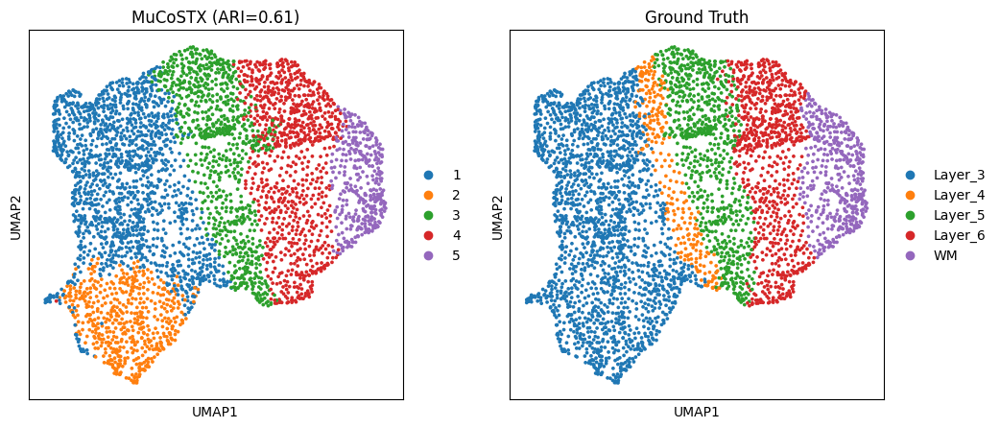

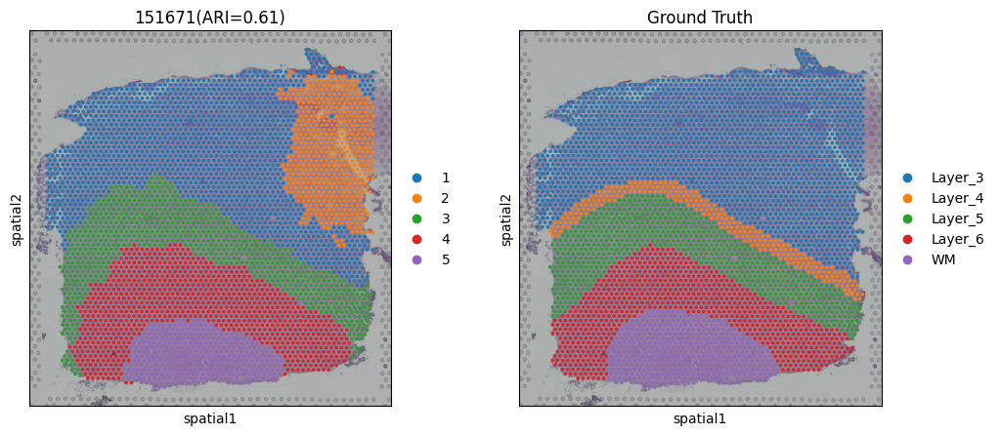

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


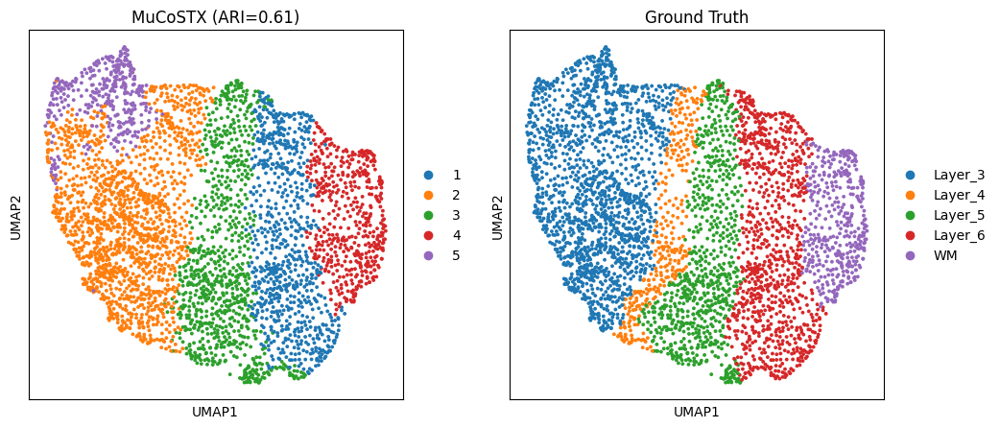

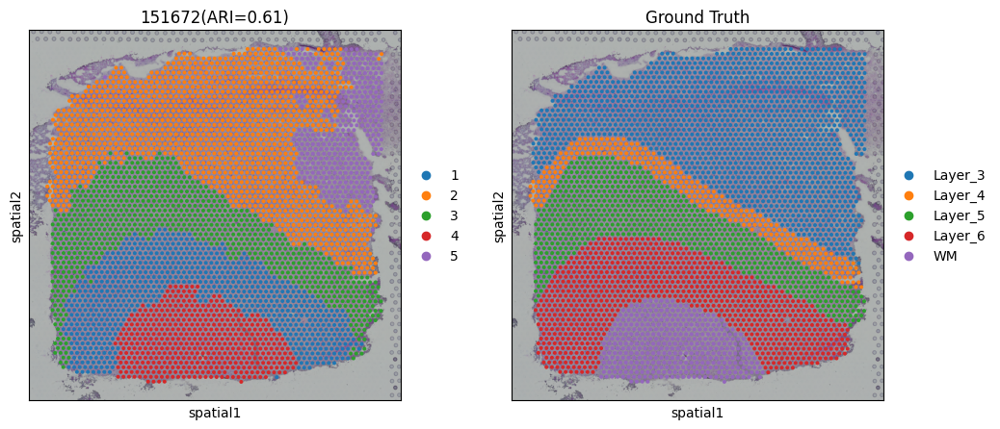

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


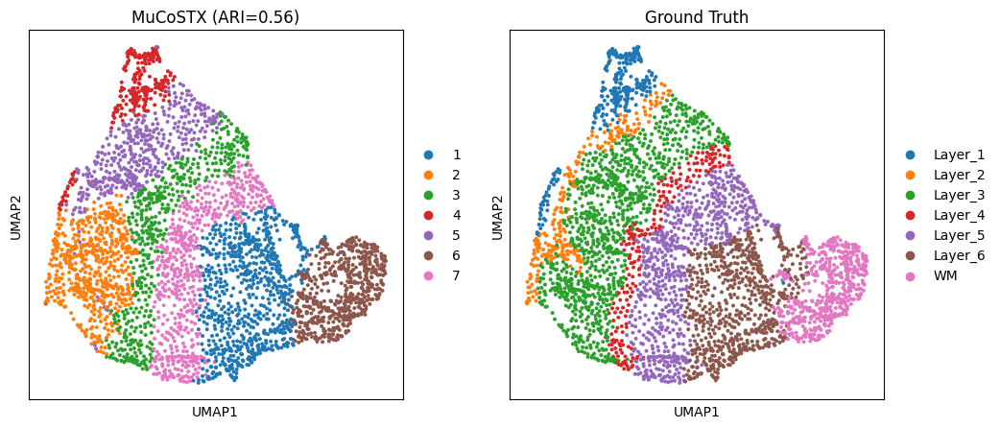

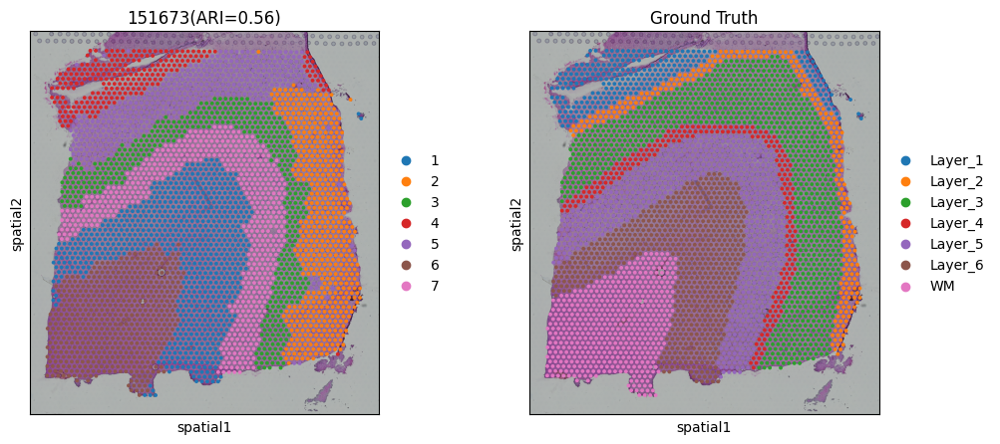

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


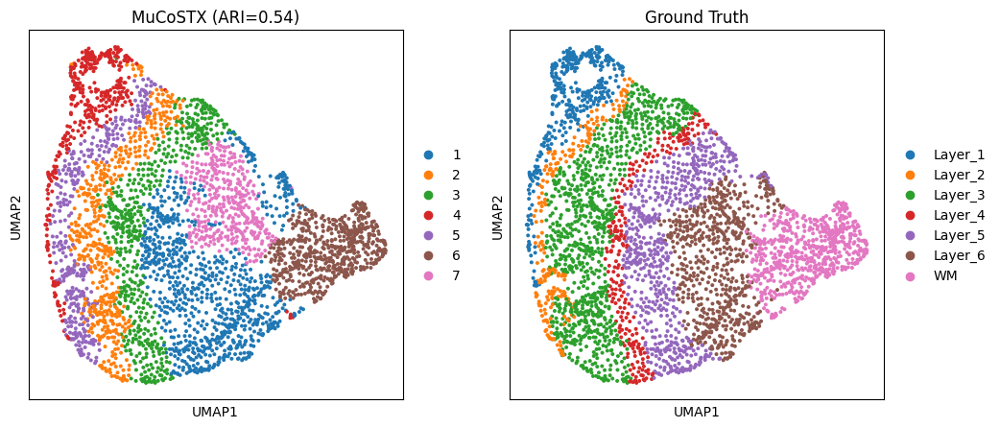

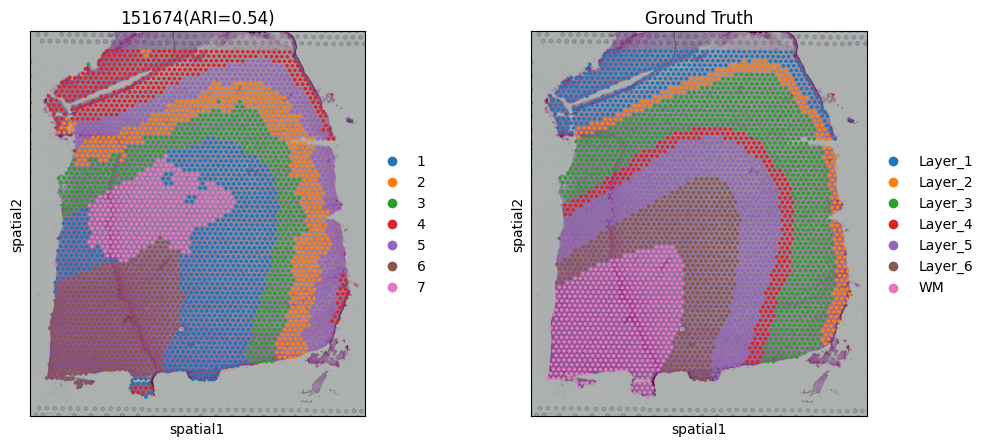

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


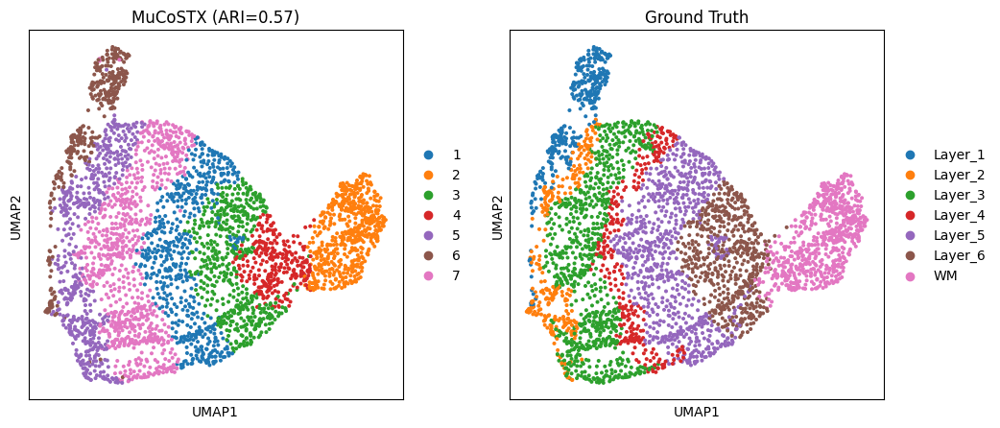

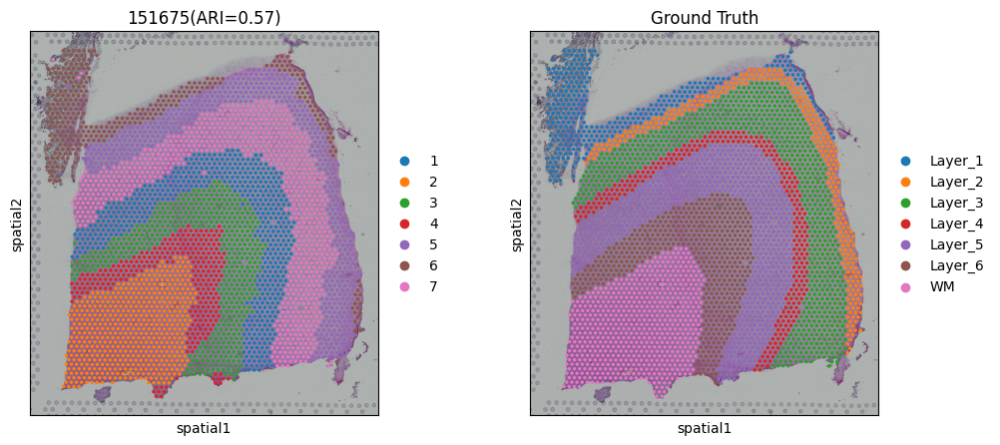

fitting ...
  |======================================================================| 100%


/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zl/anaconda3/envs/pyg/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


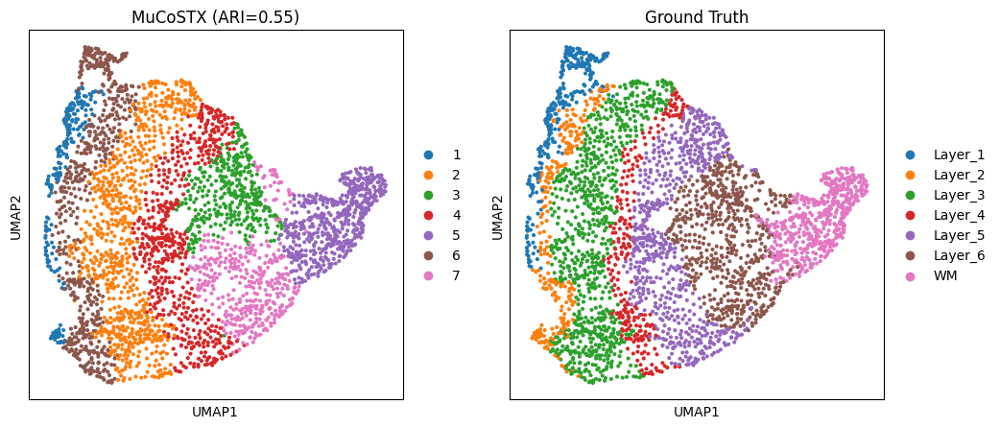

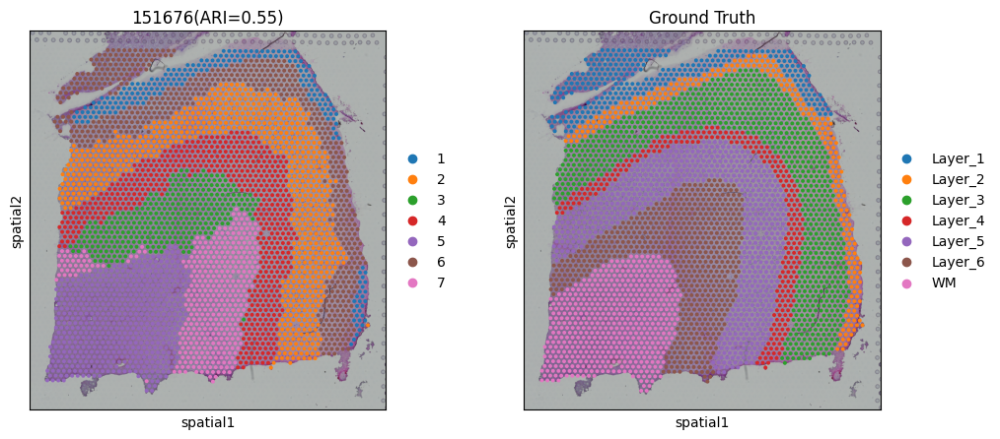

In [ ]:
ari = []
from sklearn.metrics import adjusted_rand_score
from mucostx.utils import mclust
n_d = [7,7,7,7,5,5,5,5,7,7,7,7]
# n_d = [7,7,7,7]
for i in range(12):
    adata_i = list_new[i]
    args.n_domain=n_d[i]
    adata_i = mclust(adata_i, args, refine=False, use='mx')
    adata_i = adata_i[~pd.isnull(adata_i.obs['Ground Truth'])]
    obs_df = adata_i.obs.dropna()
    ARI = adjusted_rand_score(obs_df['mclust'], obs_df['Ground Truth'])
    ari.append(ARI)
    sc.pp.neighbors(adata_i, use_rep='mx')
    sc.tl.umap(adata_i)
    plt.rcParams["figure.figsize"] = (5, 5)
    sc.pl.umap(adata_i, color=["mclust", "Ground Truth"], title=['MuCoSTX (ARI=%.2f)'%ARI, "Ground Truth"])
    sc.pl.spatial(adata_i,color=["mclust", "Ground Truth"], title=sections[i]+'(ARI=%.2f)'%ARI)

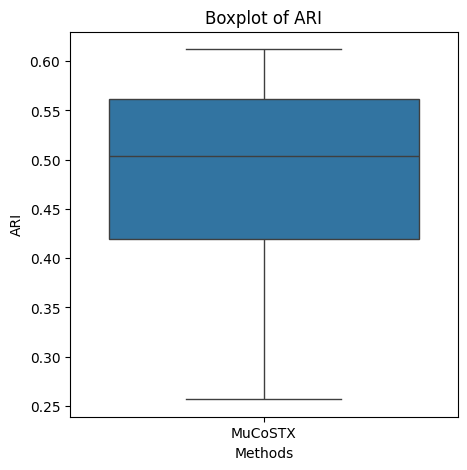

In [ ]:
import seaborn as sns
import pandas as pd

# 示例数据：多个列表
data = {
    "MuCoSTX": ari,
}

# 转换为 DataFrame
df = pd.DataFrame(dict([(k, pd.Series(v)) for k, v in data.items()]))

# 转换为长格式
df_melted = df.melt(var_name="Methods", value_name="ARI")

# 绘制箱线图
sns.boxplot(x="Methods", y="ARI", data=df_melted)

# 添加标题
plt.title("Boxplot of ARI")

# 显示图像
plt.show()
